In [ ]:
'''
모델
 - OLS (Ordinary Least Squares)
 - LinearRegression
 - 의사결정나무
 - SVM
 - 랜덤포레스트
 - 인공신경망

모델 결정을 위한 함수
 - mean_squared_error : 평균제곱근오차 함수
 - GridSearchCV : 파라미터 튜닝
 - RandomizedSearchCV : 파라미터 최적화 함수
'''

# 데이터 불러오기

In [1]:
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import dataframe_image as dfi

# 그래프에서 마이너스 폰트 깨지는 문제에 대한 대처
mpl.rcParams['axes.unicode_minus'] = False

# 폰트 지정하기
plt.rcParams['font.family'] = 'gulim'

In [2]:
df = pd.read_csv("c:/nba_salary/csv/preprocess.csv")
df.head()

,salary,Season,Age,G,GS,MP,FG,FGA,FG%,3P,...,STL,BLK,TOV,PF,PTS,pos_C,pos_PF,pos_PG,pos_SF,pos_SG
0,996827.0,1990,27.0,0.500000,0.592593,0.256801,-0.170905,-0.220114,0.614286,-0.266667,...,-0.042553,0.384615,0.034091,1.196429,-0.174579,1,0,0,0,0
1,1881882.0,1990,27.0,0.473684,1.037037,0.949229,0.887080,1.115750,-0.557143,2.316667,...,1.765957,-0.461538,0.840909,0.169643,1.140888,0,0,1,0,0
2,2543393.0,1990,30.0,0.447368,0.407407,0.474441,1.049847,0.943074,0.671429,0.200000,...,-0.085106,0.153846,0.613636,0.776786,0.954058,0,0,0,1,0
3,1653775.0,1990,30.0,0.368421,0.925926,0.974874,1.326551,1.428843,-0.042857,1.483333,...,1.595745,0.115385,1.340909,1.107143,1.326187,0,0,1,0,0
4,1140535.0,1990,26.0,0.552632,-0.148148,0.396812,0.777213,0.728653,0.457143,-0.150000,...,0.468085,0.923077,0.386364,0.937500,0.588055,0,1,0,0,0


# 분석

In [3]:
dfX = df.iloc[:, 2:]
dfy = df.iloc[:, 0]

In [4]:
dfX

,Age,G,GS,MP,FG,FGA,FG%,3P,3PA,3P%,...,STL,BLK,TOV,PF,PTS,pos_C,pos_PF,pos_PG,pos_SF,pos_SG
0,27.0,0.500000,0.592593,0.256801,-0.170905,-0.220114,0.614286,-0.266667,-0.339286,2.566265,...,-0.042553,0.384615,0.034091,1.196429,-0.174579,1,0,0,0,0
1,27.0,0.473684,1.037037,0.949229,0.887080,1.115750,-0.557143,2.316667,2.208333,0.253012,...,1.765957,-0.461538,0.840909,0.169643,1.140888,0,0,1,0,0
2,30.0,0.447368,0.407407,0.474441,1.049847,0.943074,0.671429,0.200000,0.190476,0.054217,...,-0.085106,0.153846,0.613636,0.776786,0.954058,0,0,0,1,0
3,30.0,0.368421,0.925926,0.974874,1.326551,1.428843,-0.042857,1.483333,1.357143,0.301205,...,1.595745,0.115385,1.340909,1.107143,1.326187,0,0,1,0,0
4,26.0,0.552632,-0.148148,0.396812,0.777213,0.728653,0.457143,-0.150000,-0.071429,-0.722892,...,0.468085,0.923077,0.386364,0.937500,0.588055,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11921,22.0,0.052632,0.833333,0.557616,1.249237,1.349146,-0.042857,1.950000,2.000000,0.114458,...,0.319149,-0.115385,2.204545,-0.026786,1.712098,0,0,1,0,0
11922,28.0,-0.342105,0.055556,-0.218680,0.004069,-0.146110,1.685714,-0.250000,-0.196429,-1.090361,...,-0.234043,0.076923,-0.181818,0.062500,-0.038285,1,0,0,0,0
11923,28.0,-0.342105,0.055556,-0.218680,0.004069,-0.146110,1.685714,-0.250000,-0.196429,-1.090361,...,-0.234043,0.076923,-0.181818,0.062500,-0.038285,1,0,0,0,0
11924,23.0,0.289474,0.277778,0.199965,0.313327,-0.013283,3.014286,-0.300000,-0.339286,-0.445783,...,-0.297872,1.807692,0.159091,0.651786,0.266462,1,0,0,0,0


In [5]:
dfX.columns

Index(['Age', 'G', 'GS', 'MP', 'FG', 'FGA', 'FG%', '3P', '3PA', '3P%', '2P',
       '2PA', '2P%', 'eFG%', 'FT', 'FTA', 'FT%', 'ORB', 'DRB', 'TRB', 'AST',
       'STL', 'BLK', 'TOV', 'PF', 'PTS', 'pos_C', 'pos_PF', 'pos_PG', 'pos_SF',
       'pos_SG'],
      dtype='object')

In [6]:
from sklearn.model_selection import train_test_split
import statsmodels.api as sm

dfX_train, dfX_test, dfy_train, dfy_test = train_test_split(dfX, dfy, test_size=0.2, random_state=10)

model = sm.OLS(dfy_train, dfX_train)
result = model.fit()
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 salary   R-squared:                       0.454
Model:                            OLS   Adj. R-squared:                  0.453
Method:                 Least Squares   F-statistic:                     304.6
Date:                Fri, 24 Mar 2023   Prob (F-statistic):               0.00
Time:                        15:03:02   Log-Likelihood:            -1.6172e+05
No. Observations:                9540   AIC:                         3.235e+05
Df Residuals:                    9513   BIC:                         3.237e+05
Df Model:                          26                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Age         3.083e+05   1.48e+04     20.815      0.000    2.79e+05    3.37e+05
G          -2.763e+06   2.32e+05    -11.927      0.000   -3.22e+06   -2.31e+06
GS          2.321e+06   2.43e+05      9.551      0.000    1.84e+06     2.8e+06
MP         -6.639e+06   5.46e+05    -12.168      0.000   -7.71e+06   -5.57e+06
FG          2.025e+06   3.13e+05      6.470      0.000    1.41e+06    2.64e+06
FGA         2.018e+06   4.22e+05      4.779      0.000    1.19e+06    2.85e+06
FG%          2.16e+06   2.24e+05      9.660      0.000    1.72e+06     2.6e+06
3P         -5.442e+05   5.95e+05     -0.915      0.360   -1.71e+06    6.21e+05
3PA         3.679e+06    6.4e+05      5.745      0.000    2.42e+06    4.93e+06
3P%         6.672e+04   7.91e+04      0.843      0.399   -8.84e+04    2.22e+05
2P         -1.055e+05   4.38e+05     -0.241      0.809   -9.64e+05    7.52e+05
2PA        -1.761e+06   5.27e+05     -3.344      0.001   -2.79e+06   -7.29e+05
2P%        -1.314e+05   1.21e+05     -1.085      0.278   -3.69e+05    1.06e+05
eFG%       -1.683e+06   2.03e+05     -8.299      0.000   -2.08e+06   -1.29e+06
FT         -1.882e+06   5.52e+05     -3.409      0.001   -2.96e+06      -8e+05
FTA          2.93e+06   6.08e+05      4.817      0.000    1.74e+06    4.12e+06
FT%         2.898e+05   8.48e+04      3.419      0.001    1.24e+05    4.56e+05
ORB        -1.636e+06   1.66e+05     -9.881      0.000   -1.96e+06   -1.31e+06
DRB          3.03e+06   1.47e+05     20.639      0.000    2.74e+06    3.32e+06
TRB         2.219e+06    8.4e+04     26.408      0.000    2.05e+06    2.38e+06
AST         1.682e+06    1.6e+05     10.496      0.000    1.37e+06       2e+06
STL        -7.769e+05   1.56e+05     -4.983      0.000   -1.08e+06   -4.71e+05
BLK         4.049e+05      7e+04      5.782      0.000    2.68e+05    5.42e+05
TOV        -8.767e+05   2.88e+05     -3.041      0.002   -1.44e+06   -3.12e+05
PF         -9.978e+05   2.39e+05     -4.181      0.000   -1.47e+06    -5.3e+05
PTS         2.002e+06   2.65e+05      7.556      0.000    1.48e+06    2.52e+06
pos_C      -4.387e+06   4.61e+05     -9.522      0.000   -5.29e+06   -3.48e+06
pos_PF      -4.41e+06   4.18e+05    -10.539      0.000   -5.23e+06   -3.59e+06
pos_PG     -5.316e+06   4.08e+05    -13.037      0.000   -6.11e+06   -4.52e+06
pos_SF     -4.898e+06   4.01e+05    -12.207      0.000   -5.68e+06   -4.11e+06
pos_SG     -5.005e+06   3.96e+05    -12.642      0.000   -5.78e+06   -4.23e+06
==============================================================================
Omnibus:                     2613.866   Durbin-Watson:                   1.966
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            10956.374
Skew:                           1.293   Prob(JB):                         0.00
Kurtosis:                       7.569   Cond. No.                     1.00e+16
==

In [7]:
# 다중공선성 의심

## 다중공선성 해결

In [7]:
import seaborn as sns

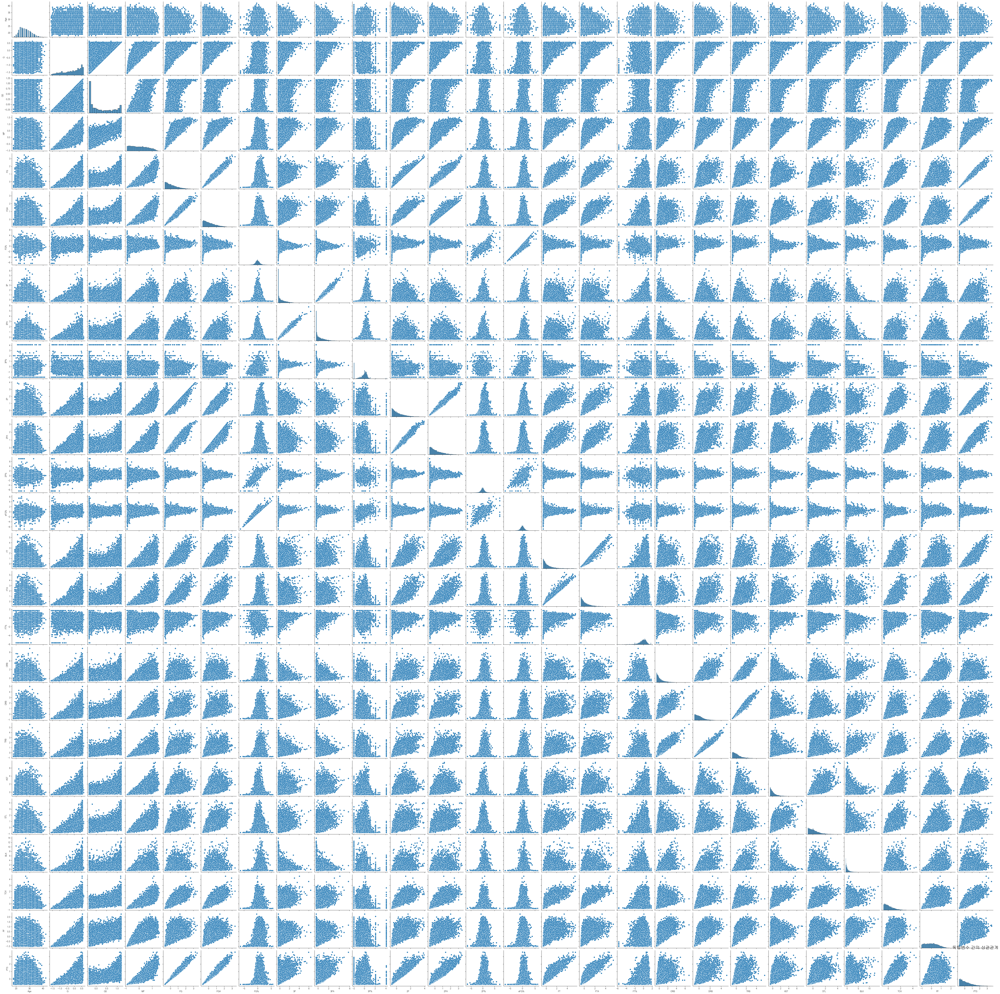

In [8]:
sns.pairplot(dfX.iloc[:, :-5])
plt.title('독립변수 간의 상관관계', fontsize=20)
plt.savefig('./plot/독립변수 간의 상관관계(scatter).png')
plt.show()

In [9]:
dfX.corr()

,Age,G,GS,MP,FG,FGA,FG%,3P,3PA,3P%,...,STL,BLK,TOV,PF,PTS,pos_C,pos_PF,pos_PG,pos_SF,pos_SG
Age,1.000000,0.042109,0.059014,0.067810,0.020243,0.021059,0.007357,0.068732,0.056271,0.048902,...,0.038497,-0.025513,0.000019,0.030747,0.022316,0.046974,0.003157,0.014745,-0.019306,-0.038409
G,0.042109,1.000000,0.594711,0.836196,0.692614,0.698443,0.291069,0.388099,0.403457,0.027923,...,0.669918,0.418232,0.674578,0.828233,0.681565,0.049610,0.025477,-0.034496,0.007455,-0.038784
GS,0.059014,0.594711,1.000000,0.863252,0.811681,0.807620,0.270207,0.413150,0.428430,0.049725,...,0.719388,0.457106,0.777047,0.705044,0.803828,0.046213,-0.005606,-0.014669,0.017753,-0.035534
MP,0.067810,0.836196,0.863252,1.000000,0.915520,0.921606,0.293634,0.510555,0.530925,0.084773,...,0.829286,0.476019,0.875340,0.847348,0.911241,-0.014046,0.004507,-0.012336,0.029857,-0.008830
FG,0.020243,0.692614,0.811681,0.915520,1.000000,0.988563,0.332293,0.489423,0.508415,0.087332,...,0.757375,0.470413,0.886276,0.741110,0.991993,-0.006979,0.021004,-0.041556,0.019029,0.008658
FGA,0.021059,0.698443,0.807620,0.921606,0.988563,1.000000,0.238470,0.553895,0.579723,0.121404,...,0.774977,0.416017,0.892380,0.727759,0.987810,-0.057264,-0.004885,-0.011585,0.028455,0.036810
FG%,0.007357,0.291069,0.270207,0.293634,0.332293,0.238470,1.000000,-0.086380,-0.112400,-0.086994,...,0.182051,0.381806,0.244726,0.365767,0.299587,0.331842,0.137917,-0.194336,-0.048568,-0.170564
3P,0.068732,0.388099,0.413150,0.510555,0.489423,0.553895,-0.086380,1.000000,0.990240,0.444986,...,0.451428,-0.051333,0.410753,0.257977,0.545294,-0.258393,-0.144814,0.092116,0.067923,0.198660
3PA,0.056271,0.403457,0.428430,0.530925,0.508415,0.579723,-0.112400,0.990240,1.000000,0.424823,...,0.483248,-0.045452,0.443177,0.272661,0.564068,-0.270244,-0.148554,0.102027,0.071839,0.198599
3P%,0.048902,0.027923,0.049725,0.084773,0.087332,0.121404,-0.086994,0.444986,0.424823,1.000000,...,0.105955,-0.203663,0.049959,-0.076188,0.116117,-0.293565,-0.147044,0.120793,0.105539,0.165947


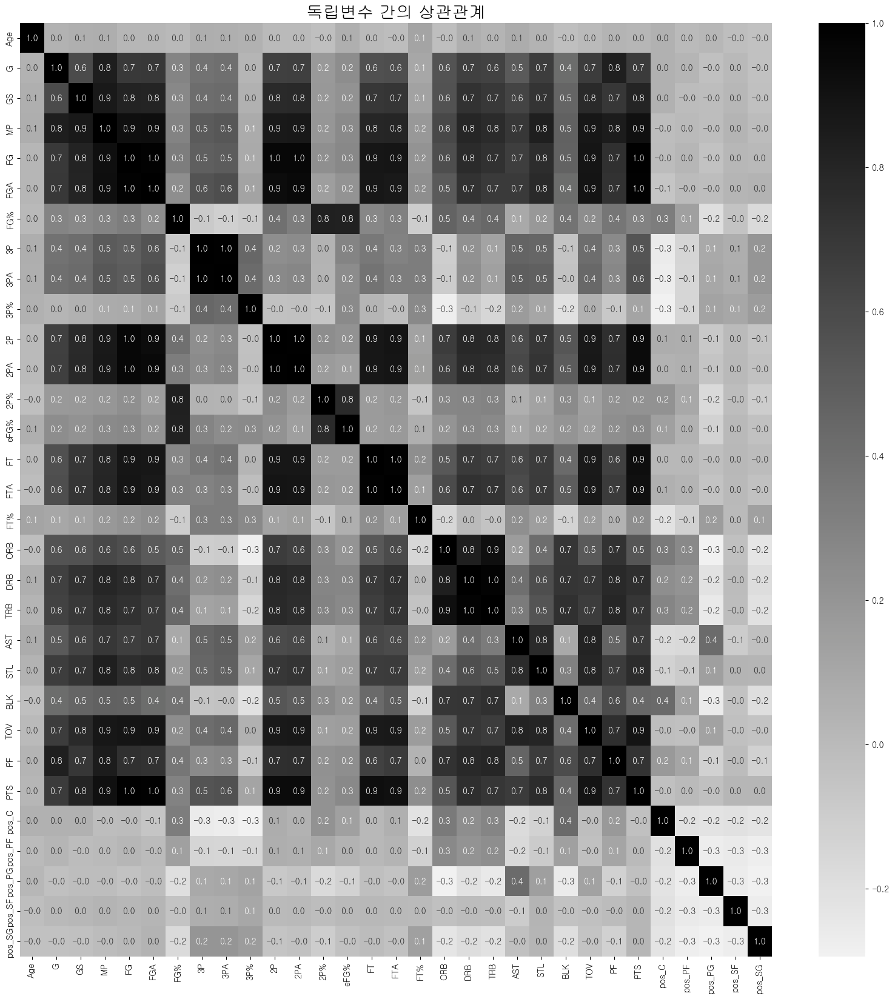

In [10]:
%matplotlib inline
plt.figure(figsize=(20,20))
cmap = sns.light_palette("black", as_cmap=True)
sns.heatmap(dfX.corr(), annot=True, fmt='3.1f', cmap=cmap)
plt.title('독립변수 간의 상관관계', fontsize=20)
plt.savefig('./plot/독립변수 간의 상관관계(히트맵).png')
plt.show()

In [11]:
# 높은 상관계수 프린트
df_corr = dfX.corr()
columns = df_corr.columns

for i in range(len(columns)):
    for j in range(len(columns)):
        if df_corr.iloc[i, j] > 0.85:
            if columns[i] != columns[j]:
                print(columns[i], "&", columns[j], ":", df_corr.iloc[i, j])

GS & MP : 0.863252167059263
MP & GS : 0.863252167059263
MP & FG : 0.9155197767833928
MP & FGA : 0.9216055513830053
MP & 2P : 0.8630413739474477
MP & 2PA : 0.872340209925626
MP & TOV : 0.8753397799909818
MP & PTS : 0.9112412984334685
FG & MP : 0.9155197767833928
FG & FGA : 0.9885628241258748
FG & 2P : 0.9636008593867575
FG & 2PA : 0.9602187764304411
FG & FT : 0.883761697869881
FG & FTA : 0.8840436009288649
FG & TOV : 0.8862762704517014
FG & PTS : 0.991992637210757
FGA & MP : 0.9216055513830053
FGA & FG : 0.9885628241258748
FGA & 2P : 0.9310986863114875
FGA & 2PA : 0.9450857199540216
FGA & FT : 0.8738332564139416
FGA & FTA : 0.8660650731799162
FGA & TOV : 0.8923802751365454
FGA & PTS : 0.9878097778048037
3P & 3PA : 0.9902400804836574
3PA & 3P : 0.9902400804836574
2P & MP : 0.8630413739474477
2P & FG : 0.9636008593867575
2P & FGA : 0.9310986863114875
2P & 2PA : 0.9911394508561587
2P & FT : 0.8748488169480624
2P & FTA : 0.8917596035709605
2P & TOV : 0.8610710188461069
2P & PTS : 0.93755512

In [12]:
# 의존적인 변수들 제거
dfX.drop(['FG', 'FGA', '3P', '3PA', '2P', '2PA','FT', 'FTA', 'TRB'], axis=1, inplace=True)

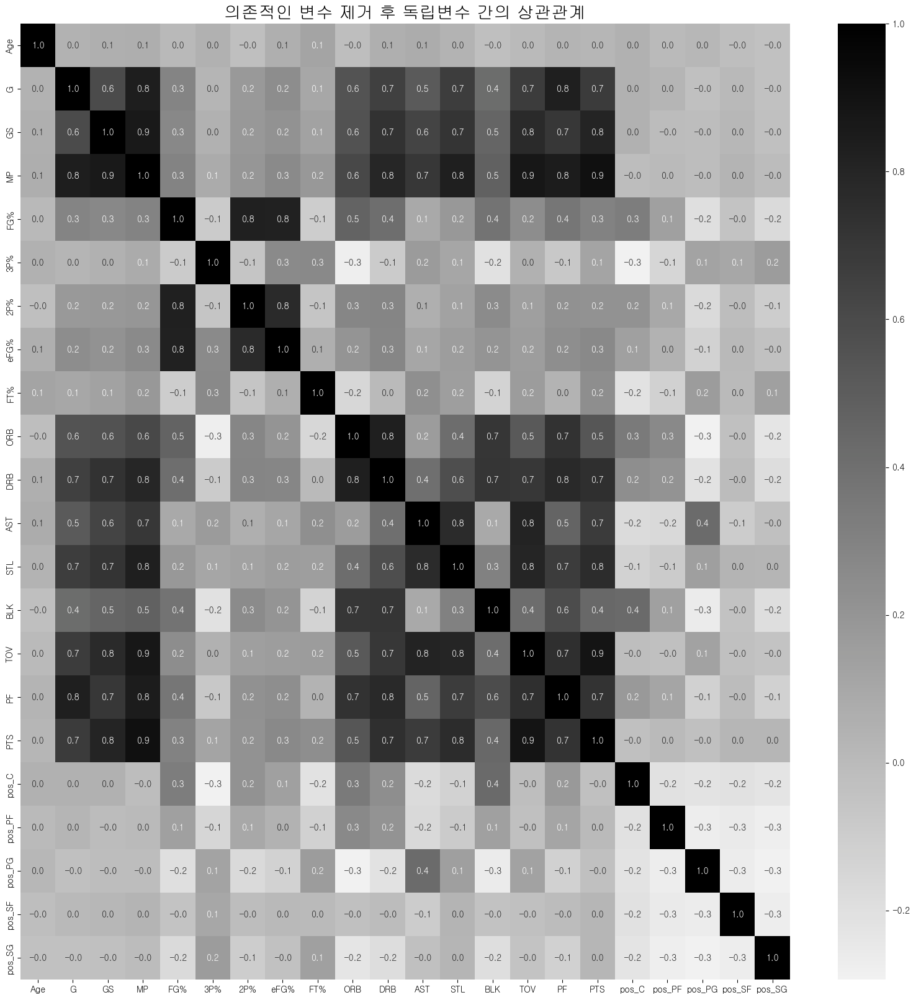

In [13]:
# 의존적인 변수들 제거 후 상관계수 다시 확인
%matplotlib inline
plt.figure(figsize=(20,20))
cmap = sns.light_palette("black", as_cmap=True)
sns.heatmap(dfX.corr(), annot=True, fmt='3.1f', cmap=cmap)
plt.title('의존적인 변수 제거 후 독립변수 간의 상관관계', fontsize=20)
plt.savefig('./plot/의존적인 변수 제거 후 독립변수 간의 상관관계(히트맵).png')
plt.show()

In [14]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(
    dfX.values, i) for i in range(dfX.shape[1])]
vif["features"] = dfX.columns
vif = vif.sort_values("VIF Factor").reset_index(drop=True)
vif

,VIF Factor,features
0,1.095714,Age
1,1.299103,FT%
2,1.747437,3P%
3,2.638214,BLK
4,3.692803,2P%
5,4.380093,STL
6,5.300981,GS
7,5.756602,ORB
8,5.815482,G
9,6.219360,eFG%


In [15]:
# 다중공선성 테스트
dfX_train, dfX_test, dfy_train, dfy_test = train_test_split(dfX, dfy, test_size=0.2, random_state=10)

model = sm.OLS(dfy_train, dfX_train)
result = model.fit()
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 salary   R-squared:                       0.430
Model:                            OLS   Adj. R-squared:                  0.429
Method:                 Least Squares   F-statistic:                     341.7
Date:                Fri, 24 Mar 2023   Prob (F-statistic):               0.00
Time:                        15:07:54   Log-Likelihood:            -1.6193e+05
No. Observations:                9540   AIC:                         3.239e+05
Df Residuals:                    9518   BIC:                         3.241e+05
Df Model:                          21                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Age          2.89e+05   1.51e+04     19.161      0.000    2.59e+05    3.19e+05
G          -2.439e+06   2.35e+05    -10.370      0.000    -2.9e+06   -1.98e+06
GS           2.21e+06   2.46e+05      8.973      0.000    1.73e+06    2.69e+06
MP         -5.319e+06   5.31e+05    -10.014      0.000   -6.36e+06   -4.28e+06
FG%        -8.199e+05   1.73e+05     -4.740      0.000   -1.16e+06   -4.81e+05
3P%        -5.563e+04   8.04e+04     -0.692      0.489   -2.13e+05    1.02e+05
2P%         2.963e+05   1.12e+05      2.642      0.008    7.65e+04    5.16e+05
eFG%        6.694e+05   1.58e+05      4.225      0.000    3.59e+05     9.8e+05
FT%        -1.461e+04   7.64e+04     -0.191      0.848   -1.64e+05    1.35e+05
ORB        -1.836e+06   1.55e+05    -11.843      0.000   -2.14e+06   -1.53e+06
DRB           4.8e+06   1.99e+05     24.141      0.000    4.41e+06    5.19e+06
AST         1.552e+06   1.61e+05      9.640      0.000    1.24e+06    1.87e+06
STL        -5.496e+05   1.58e+05     -3.474      0.001    -8.6e+05    -2.4e+05
BLK         2.588e+05   7.01e+04      3.693      0.000    1.21e+05    3.96e+05
TOV        -9.228e+05   2.75e+05     -3.352      0.001   -1.46e+06   -3.83e+05
PF         -1.085e+06   2.43e+05     -4.458      0.000   -1.56e+06   -6.08e+05
PTS         6.847e+06   2.65e+05     25.859      0.000    6.33e+06    7.37e+06
pos_C      -2.428e+06   4.84e+05     -5.020      0.000   -3.38e+06   -1.48e+06
pos_PF     -2.862e+06   4.44e+05     -6.441      0.000   -3.73e+06   -1.99e+06
pos_PG     -3.989e+06   4.36e+05     -9.153      0.000   -4.84e+06   -3.13e+06
pos_SF     -3.531e+06   4.29e+05     -8.228      0.000   -4.37e+06   -2.69e+06
pos_SG     -3.654e+06   4.23e+05     -8.631      0.000   -4.48e+06   -2.82e+06
==============================================================================
Omnibus:                     2635.762   Durbin-Watson:                   1.973
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            11265.238
Skew:                           1.298   Prob(JB):                         0.00
Kurtosis:                       7.648   Cond. No.                         439.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [17]:
# 조건변수 24로 좋아짐

## 후진제거법

In [16]:
# 유의하지 않은 변수들(p-value > 0.05) 제거
# '3P%', 'FT%'
dfX.drop(['3P%', 'FT%'], axis=1, inplace=True)

# 모델

In [17]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(dfX, dfy, test_size=0.2, random_state=0)
print(X_train.shape, X_test.shape)

(9540, 20) (2386, 20)


In [18]:
from sklearn.metrics import mean_squared_error
import numpy as np

### OLS

In [19]:
model_OLS = sm.OLS(y_train, X_train)
result_OLS = model_OLS.fit()
result_OLS.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 salary   R-squared:                       0.429
Model:                            OLS   Adj. R-squared:                  0.428
Method:                 Least Squares   F-statistic:                     376.9
Date:                Fri, 24 Mar 2023   Prob (F-statistic):               0.00
Time:                        15:08:03   Log-Likelihood:            -1.6180e+05
No. Observations:                9540   AIC:                         3.236e+05
Df Residuals:                    9520   BIC:                         3.238e+05
Df Model:                          19                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Age         2.849e+05   1.47e+04     19.370      0.000    2.56e+05    3.14e+05
G          -2.516e+06   2.33e+05    -10.792      0.000   -2.97e+06   -2.06e+06
GS           2.07e+06   2.44e+05      8.494      0.000    1.59e+06    2.55e+06
MP         -4.726e+06   5.27e+05     -8.975      0.000   -5.76e+06   -3.69e+06
FG%        -7.003e+05   1.66e+05     -4.210      0.000   -1.03e+06   -3.74e+05
2P%         2.715e+05   1.08e+05      2.507      0.012    5.92e+04    4.84e+05
eFG%        5.567e+05   1.36e+05      4.084      0.000     2.9e+05    8.24e+05
ORB        -1.996e+06   1.52e+05    -13.162      0.000   -2.29e+06    -1.7e+06
DRB         4.927e+06   1.97e+05     24.958      0.000    4.54e+06    5.31e+06
AST         1.555e+06   1.59e+05      9.765      0.000    1.24e+06    1.87e+06
STL        -7.232e+05   1.56e+05     -4.630      0.000   -1.03e+06   -4.17e+05
BLK         2.423e+05   6.87e+04      3.529      0.000    1.08e+05    3.77e+05
TOV         -9.74e+05   2.71e+05     -3.588      0.000   -1.51e+06   -4.42e+05
PF         -1.128e+06   2.39e+05     -4.723      0.000    -1.6e+06    -6.6e+05
PTS         6.762e+06   2.59e+05     26.126      0.000    6.25e+06    7.27e+06
pos_C      -2.342e+06   4.72e+05     -4.959      0.000   -3.27e+06   -1.42e+06
pos_PF     -2.628e+06   4.32e+05     -6.081      0.000   -3.47e+06   -1.78e+06
pos_PG     -3.857e+06   4.28e+05     -9.017      0.000    -4.7e+06   -3.02e+06
pos_SF     -3.245e+06   4.17e+05     -7.775      0.000   -4.06e+06   -2.43e+06
pos_SG     -3.487e+06   4.12e+05     -8.460      0.000   -4.29e+06   -2.68e+06
==============================================================================
Omnibus:                     2595.801   Durbin-Watson:                   2.004
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            10296.105
Skew:                           1.302   Prob(JB):                         0.00
Kurtosis:                       7.372   Cond. No.                         434.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
'''
OLS               : 42.9%
LinearRegression  : 
의사결정나무       : 
SVM               : 
랜덤포레스트       : 
인공신경망         : 
'''

### LinearRegression

In [20]:
from sklearn.linear_model import LinearRegression

model_lin_reg = LinearRegression()
result_lin_reg = model_lin_reg.fit(X_train, y_train)

y_pred = model_lin_reg.predict(X_test)
rms = np.sqrt(mean_squared_error(y_test, y_pred))

print("학습용 데이터셋 정확도 :", result_lin_reg.score(X_train, y_train))
print("검증용 데이터셋 정확도 :", result_lin_reg.score(X_test, y_test))
print("오차 :", rms)

학습용 데이터셋 정확도 : 0.4292617286176619
검증용 데이터셋 정확도 : 0.4295291230529896
오차 : 5832739.273654865


In [ ]:
'''
OLS               : 42.9%
LinearRegression  : 42.9%
의사결정나무       : 
SVM               : 
랜덤포레스트       : 
인공신경망         : 
'''

### 의사결정나무

In [21]:
from sklearn.tree import DecisionTreeClassifier

model_tree_reg = DecisionTreeClassifier(max_depth=3)
result_tree_reg = model_tree_reg.fit(X_train, round(np.log(y_train)))

y_pred = model_tree_reg.predict(X_test)
rms = np.sqrt(mean_squared_error(y_test, y_pred))

print("학습용 데이터셋 정확도 :", result_tree_reg.score(X_train, round(np.log(y_train))))
print("검증용 데이터셋 정확도 :", result_tree_reg.score(X_test, round(np.log(y_test))))
print("오차 :", rms)

학습용 데이터셋 정확도 : 0.4061844863731656
검증용 데이터셋 정확도 : 0.40360435875943
오차 : 10259356.55402842


In [ ]:
'''
OLS               : 42.9%
LinearRegression  : 42.9%
의사결정나무       : 40.6%
SVM               : 
랜덤포레스트       : 
인공신경망         : 
'''

### SVM

In [22]:
from sklearn.svm import SVR
#model_svm_reg = SVR(kernel="linear")
model_svm_reg = SVR()
result_svm_reg = model_svm_reg.fit(X_train, np.log(y_train))

y_pred = model_svm_reg.predict(X_test)
rms = np.sqrt(mean_squared_error(y_test, y_pred))

print("학습용 데이터셋 정확도 :", result_svm_reg.score(X_train, np.log(y_train)))
print("검증용 데이터셋 정확도 :", result_svm_reg.score(X_test, np.log(y_test)))
print("오차 :", rms)

학습용 데이터셋 정확도 : 0.43135914239230655
검증용 데이터셋 정확도 : 0.43824679528900445
오차 : 10259356.5608366


In [ ]:
'''
OLS               : 42.9%
LinearRegression  : 42.9%
의사결정나무       : 40.6%
SVM               : 43.1%
랜덤포레스트       : 
인공신경망         : 
'''

### RandomForest

In [23]:
from sklearn.ensemble import RandomForestRegressor
model_forest_reg = RandomForestRegressor(n_jobs=-1)
result_forest_reg = model_forest_reg.fit(X_train, y_train)

y_pred = model_forest_reg.predict(X_test)
rms = np.sqrt(mean_squared_error(y_test, y_pred))

print("학습용 데이터셋 정확도 :", result_forest_reg.score(X_train, y_train))
print("검증용 데이터셋 정확도 :", result_forest_reg.score(X_test, y_test))
print("오차 :", rms)

학습용 데이터셋 정확도 : 0.9405331662753356
검증용 데이터셋 정확도 : 0.6160609357843445
오차 : 4785055.458689835


In [24]:
# 파라미터 튜닝
from sklearn.model_selection import GridSearchCV

param_grid = [
    {'n_estimators': [3, 10, 30, 50, 100], 'max_features':[2, 4, 6, 8]},
]

forest_reg = RandomForestRegressor(random_state=0,n_jobs=-1)
grid_search = GridSearchCV(forest_reg, param_grid, cv=5)
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=RandomForestRegressor(n_jobs=-1, random_state=0),
             param_grid=[{'max_features': [2, 4, 6, 8],
                          'n_estimators': [3, 10, 30, 50, 100]}])

In [25]:
# 실험을 통해 얻은 최적의 파라미터
grid_search.best_params_

{'max_features': 6, 'n_estimators': 100}

In [26]:
# 최적의 모형
grid_search.best_estimator_

RandomForestRegressor(max_features=6, n_jobs=-1, random_state=0)

In [27]:
model_forest_reg1 = grid_search.best_estimator_
result_forest_reg1 = model_forest_reg1.fit(X_train, y_train)

y_pred = model_forest_reg1.predict(X_test)
rms = np.sqrt(mean_squared_error(y_test, y_pred))

print("학습용 데이터셋 정확도 :", result_forest_reg1.score(X_train, y_train))
print("검증용 데이터셋 정확도 :", result_forest_reg1.score(X_test, y_test))
print("오차 :", rms)

학습용 데이터셋 정확도 : 0.9405451806376448
검증용 데이터셋 정확도 : 0.616396511548196
오차 : 4782963.851175223


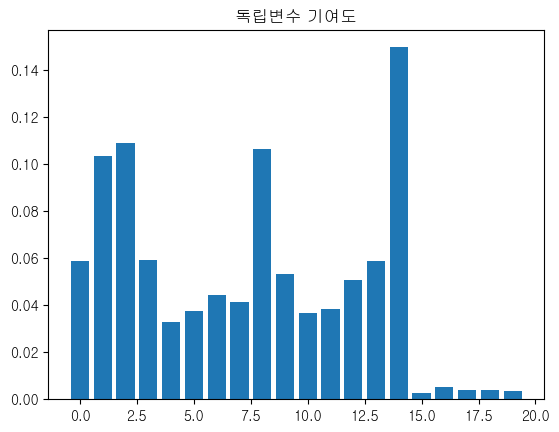

In [28]:
# 랜덤 포레스트 모형을 만드는데 가장 기여도가 큰 변수 확인
feature_importances = grid_search.best_estimator_.feature_importances_
plt.bar(range(len(feature_importances)), feature_importances)
plt.title('독립변수 기여도')
plt.savefig('./plot/독립변수 기여도(랜덤 포레스트).png')
plt.show()

In [29]:
# 파라미터 최적화 함수
# 매개변수의 범위를 지정해주면 무작위로 매개변수를 조합하여 최적의 성능 측정
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint

param_distribs = {
    'n_estimators' : randint(low=1, high=100),
    'max_features' : randint(low=1, high=8),
    }

forest_reg = RandomForestRegressor(random_state=0, n_jobs=-1)
rnd_search = RandomizedSearchCV(forest_reg, param_distributions=param_distribs, n_iter=10, cv=5, random_state=0)
rnd_search.fit(X_train, y_train)

RandomizedSearchCV(cv=5,
                   estimator=RandomForestRegressor(n_jobs=-1, random_state=0),
                   param_distributions={'max_features': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x000001B817B694C0>,
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x000001B817B69A00>},
                   random_state=0)

In [30]:
cvres = rnd_search.cv_results_
for mean_score, params in zip(cvres["mean_test_score"], cvres["params"]):
    print(np.sqrt(mean_score), params)

0.7458336684875507 {'max_features': 5, 'n_estimators': 48}
0.7528715852118291 {'max_features': 6, 'n_estimators': 65}
0.7461155277648008 {'max_features': 4, 'n_estimators': 68}
0.7382514788210703 {'max_features': 2, 'n_estimators': 84}
0.7499776783773435 {'max_features': 6, 'n_estimators': 37}
0.7546465822263232 {'max_features': 7, 'n_estimators': 89}
0.6847268060790712 {'max_features': 1, 'n_estimators': 13}
0.7465157767366394 {'max_features': 3, 'n_estimators': 66}
0.7492241600788809 {'max_features': 7, 'n_estimators': 40}
0.7546465822263232 {'max_features': 7, 'n_estimators': 89}


In [31]:
rnd_search.best_estimator_
# mean_score = 0.7546465822263232

RandomForestRegressor(max_features=7, n_estimators=89, n_jobs=-1,
                      random_state=0)

In [41]:
np.sqrt(cvres["mean_test_score"][-1])

0.7546465822263232

In [42]:
final_model_forest_reg = rnd_search.best_estimator_
final_result_forest_reg = final_model_forest_reg.fit(X_train, y_train)

y_pred = final_model_forest_reg.predict(X_test)
rms = np.sqrt(mean_squared_error(y_test, y_pred))

print("데이터셋 정확도 :", np.sqrt(cvres["mean_test_score"][-1]))
print("오차 :", rms)

데이터셋 정확도 : 0.7546465822263232
오차 : 4783152.430548674


In [ ]:
'''
OLS               : 42.9%
LinearRegression  : 42.9%
의사결정나무       : 40.6%
SVM               : 43.1%
랜덤포레스트       : 75.5%
인공신경망         : 
'''

### 인공신경망

In [43]:
from keras.models import Sequential
from keras.layers import Dense
model_keras = Sequential() # 신경망 모형
model_keras.add(Dense(24, input_shape=(X_train.shape[1],), activation='relu', name='input'))
model_keras.add(Dense(12, activation='relu', name='hidden-1'))
model_keras.add(Dense(6, activation='relu', name='hidden-2'))
model_keras.add(Dense(1, name='output'))
model_keras.compile(loss='mse', optimizer='adam', metrics=['mse', 'mae'])
model_keras.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (Dense)               (None, 24)                504       
                                                                 
 hidden-1 (Dense)            (None, 12)                300       
                                                                 
 hidden-2 (Dense)            (None, 6)                 78        
                                                                 
 output (Dense)              (None, 1)                 7         
                                                                 
Total params: 889
Trainable params: 889
Non-trainable params: 0
_________________________________________________________________


In [44]:
from keras.callbacks import EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=20)
hist = model_keras.fit(X_train, y_train, epochs=500, validation_split=0.2, callbacks=[early_stopping])

Epoch 1/500
239/239 [==============================] - 1s 2ms/step - loss: 99371869798400.0000 - mse: 99371869798400.0000 - mae: 6656160.0000 - val_loss: 102055284834304.0000 - val_mse: 102055284834304.0000 - val_mae: 6766548.0000
Epoch 2/500
239/239 [==============================] - 0s 1ms/step - loss: 99348482359296.0000 - mse: 99348482359296.0000 - mae: 6654594.0000 - val_loss: 101993041362944.0000 - val_mse: 101993041362944.0000 - val_mae: 6762436.0000
Epoch 3/500
239/239 [==============================] - 0s 1ms/step - loss: 99197076373504.0000 - mse: 99197076373504.0000 - mae: 6644496.0000 - val_loss: 101712962519040.0000 - val_mse: 101712962519040.0000 - val_mae: 6743959.0000
Epoch 4/500
239/239 [==============================] - 0s 1ms/step - loss: 98721786232832.0000 - mse: 98721786232832.0000 - mae: 6612664.0000 - val_loss: 100987045937152.0000 - val_mse: 100987045937152.0000 - val_mae: 6696006.5000
Epoch 5/500
239/239 [==============================] - 0s 1ms/step - loss: 9

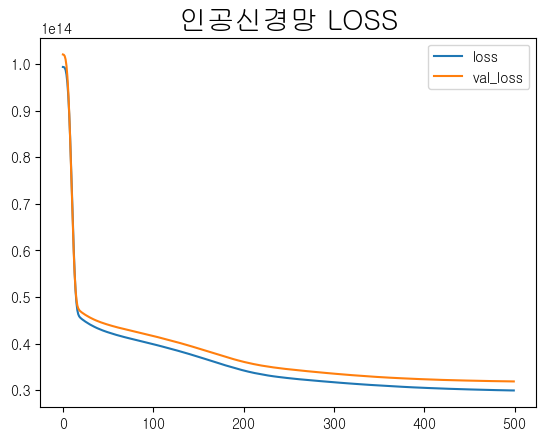

In [45]:
# 결과 시각화
plt.plot(hist.history['loss'])
plt.plot(hist.history['val_loss'])
plt.legend(['loss','val_loss'])
plt.title('인공신경망 LOSS', fontsize=20)
plt.savefig('./plot/인공신경망 LOSS 시각화.png')
plt.show()

In [46]:
# 평가
scores = model_keras.evaluate(X_train, y_train)
print(scores)

scores = model_keras.evaluate(X_test, y_test)
print(scores)

299/299 [==============================] - 0s 1ms/step - loss: 30303661850624.0000 - mse: 30303661850624.0000 - mae: 3811617.0000
[30303661850624.0, 30303661850624.0, 3811617.0]
75/75 [==============================] - 0s 930us/step - loss: 32840530001920.0000 - mse: 32840530001920.0000 - mae: 3839423.2500
[32840530001920.0, 32840530001920.0, 3839423.25]


In [50]:
from sklearn.metrics import r2_score

pred = model_keras.predict(X_test)
r2_score(y_test, pred)

75/75 [==============================] - 0s 920us/step
데이터셋 정확도 : 0.4493210142361822
299/299 [==============================] - 0s 918us/step - loss: 30303661850624.0000 - mse: 30303661850624.0000 - mae: 3811617.0000
오차 : 30303661850624.0


In [53]:
rms = model_keras.evaluate(X_train, y_train)[1]

299/299 [==============================] - 0s 915us/step - loss: 30303661850624.0000 - mse: 30303661850624.0000 - mae: 3811617.0000


In [54]:
print("데이터셋 정확도 :", r2_score(y_test, pred))
print("오차 :", rms)

데이터셋 정확도 : 0.4493210142361822
오차 : 30303661850624.0


In [ ]:
'''
OLS               : 42.9%
LinearRegression  : 42.9%
의사결정나무       : 40.6%
SVM               : 43.1%
랜덤포레스트       : 75.5%
인공신경망         : 44.9%
'''

# 결론

In [46]:
# 가장 좋은 모델은 랜덤포레스트(정확도:75.5%, 오차:$4,783,152)

In [38]:
import joblib
joblib.dump(final_model_forest_reg, 'c:/nba_salary/model/model_forest.model')

['c:/nba_salary/model/model_forest.model']

In [ ]:
'''
모델 변수(순서)
1. Age      : 나이
2. G        : 경기 출전수
3. GS       : 주전으로 시작한 경기 출전수
4. MP       : 총 경기시간(분)
5. FG%      : 슛 성공률(2점 & 3점슛 포함)
6. 2P%      : 2점슛 성공률
7. eFG%     : 3점슛 보정 슈팅효율성 수치
8. ORB      : 공격형 리바운드
9. DRB      : 수비형 리바운드
10. AST     : 어시스트
11. STL     : 스틸
12. BLK     : 블락
13. TOV     : 턴오버
14. PF      : 파울
15. PTS     : 총 득점수
16. pos_C   : 포지션 여부 - 센터
17. pos_PF  : 포지션 여부 - 파워포워드
18. pos_PG  : 포지션 여부 - 포인트가드
19. pos_SF  : 포지션 여부 - 스몰포워드
20. pos_SG  : 포지션 여부 - 슈팅가드
'''